In [84]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
import seaborn as sns
from sklearn.metrics import mean_absolute_error, r2_score
import joblib

In [2]:
%matplotlib inline 

In [3]:
df = pd.read_excel("X_bp.xlsx")
df.drop('Unnamed: 0', axis = 1, inplace = True)
df = df.iloc[22:]
df


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
22,4.029126,1880.000000,622.000000,111.860000,22.267857,284.615385,470.000000,73.333333,2455.555556,220.000000
23,2.587348,1953.274926,1136.596135,137.627420,22.344534,234.716883,555.893453,80.803222,2587.342983,246.613117
24,2.499918,1942.595777,901.519947,146.252208,23.081757,351.231874,864.725484,76.178075,3705.672523,226.222760
25,2.046471,2037.631811,707.570887,101.617251,23.146393,312.307205,547.601219,73.817067,2624.026407,178.198556
26,1.856476,2018.220332,836.294382,135.401697,26.435515,327.510377,150.961449,77.210762,2473.187195,123.344561
...,...,...,...,...,...,...,...,...,...,...
1018,2.271346,1952.087902,912.855545,86.992183,20.123249,324.774576,209.198700,73.090961,2387.292495,125.007669
1019,3.444022,2050.089171,444.732634,145.981978,19.599769,254.215401,350.660830,72.920827,2360.392784,117.730099
1020,3.280604,1972.372865,416.836524,110.533477,23.957502,248.423047,740.142791,74.734344,2662.906040,236.606764
1021,3.705351,2066.799773,741.475517,141.397963,19.246945,275.779840,641.468152,74.042708,2071.715856,197.126067


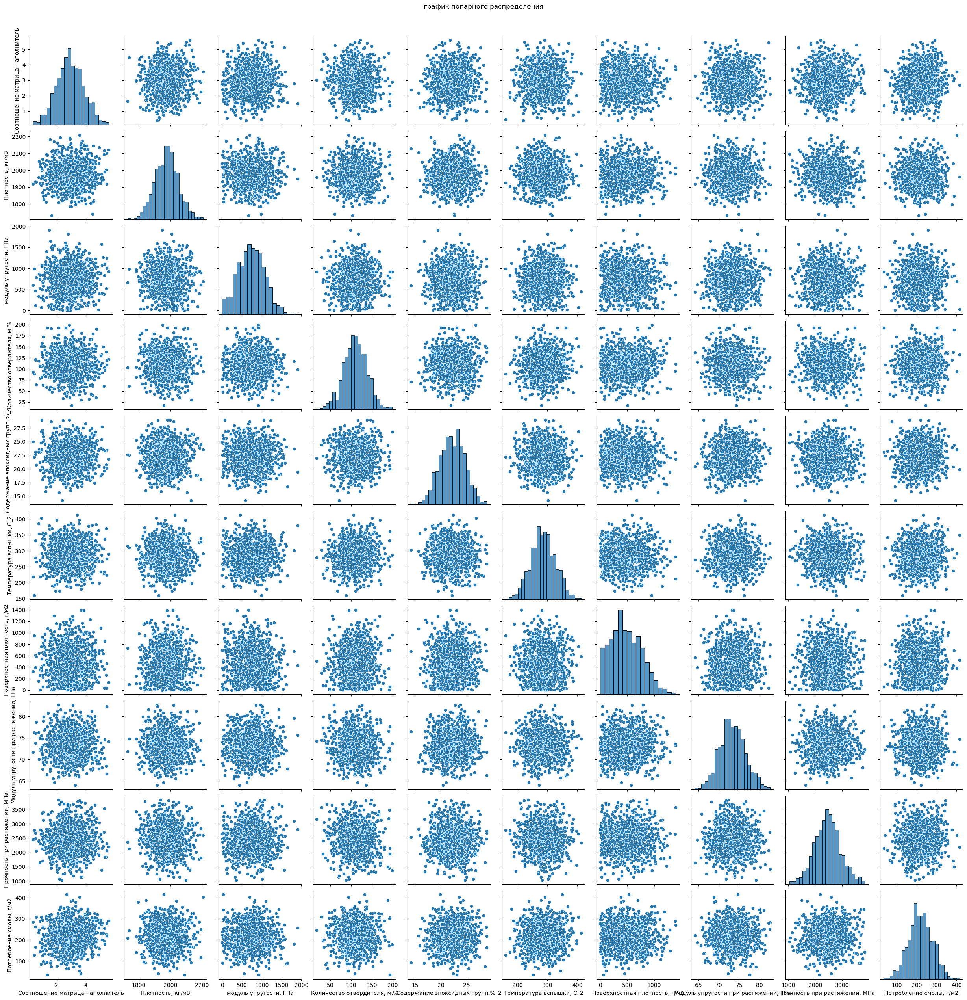

In [4]:
# Строим попарные графики
#plt.figure(figsize=(16, 9)) 
sns.pairplot(df)
plt.suptitle("график попарного распределения", y=1.02)
plt.show()

In [5]:
df.duplicated().sum()
df[df.duplicated()]


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"


In [6]:
df.groupby(["Плотность, кг/м3", "модуль упругости, ГПа"]).size()


Плотность, кг/м3  модуль упругости, ГПа
1731.764635       664.058923               1
1740.657496       984.287951               1
1784.482245       975.846909               1
1786.035636       932.145606               1
1797.648234       807.064161               1
                                          ..
2182.751822       400.855580               1
2184.493200       933.368211               1
2192.297637       898.658996               1
2192.738783       611.766338               1
2207.773481       696.149163               1
Length: 1001, dtype: int64

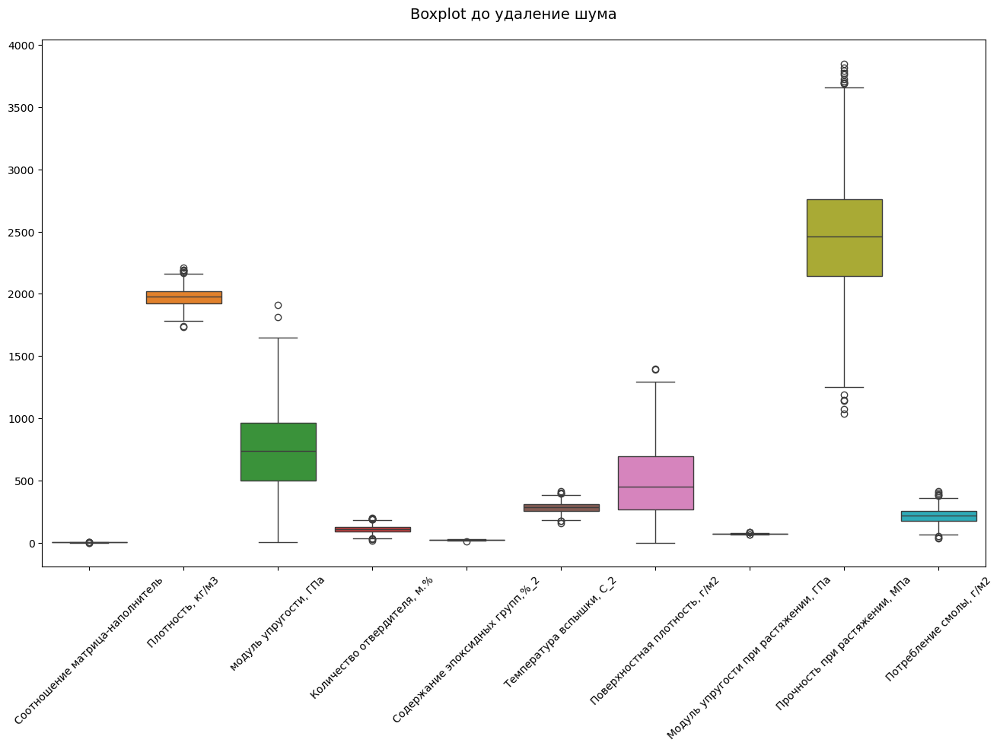

In [7]:
plt.figure(figsize=(16, 9)) 
plt.title("Boxplot до удаление шума", fontsize=14, pad=20)
sns.boxplot(data=df)
plt.xticks(rotation=45)  # Поворот подписей осей X для удобства
plt.show()

Построим бокс плот для визуализации распределения данных 

In [12]:
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1

# Границы выбросов (можно умножить IQR на коэффициент, например 1.5)
lower_bound = Q1 - 1.3 * IQR
upper_bound = Q3 + 1.3 * IQR

df_trimmed = df.copy()
for col in df.select_dtypes(include=['number']):
    df_trimmed[col] = df[col].clip(lower_bound[col], upper_bound[col])

print(df_trimmed)

In [14]:
df_trimmed = df.copy()

for col in df.select_dtypes(include='number'):
    mean_val = df[col].mean()
    mask_outliers = (df[col] < lower_bound[col]) | (df[col] > upper_bound[col])
    df_trimmed.loc[mask_outliers, col] = mean_val


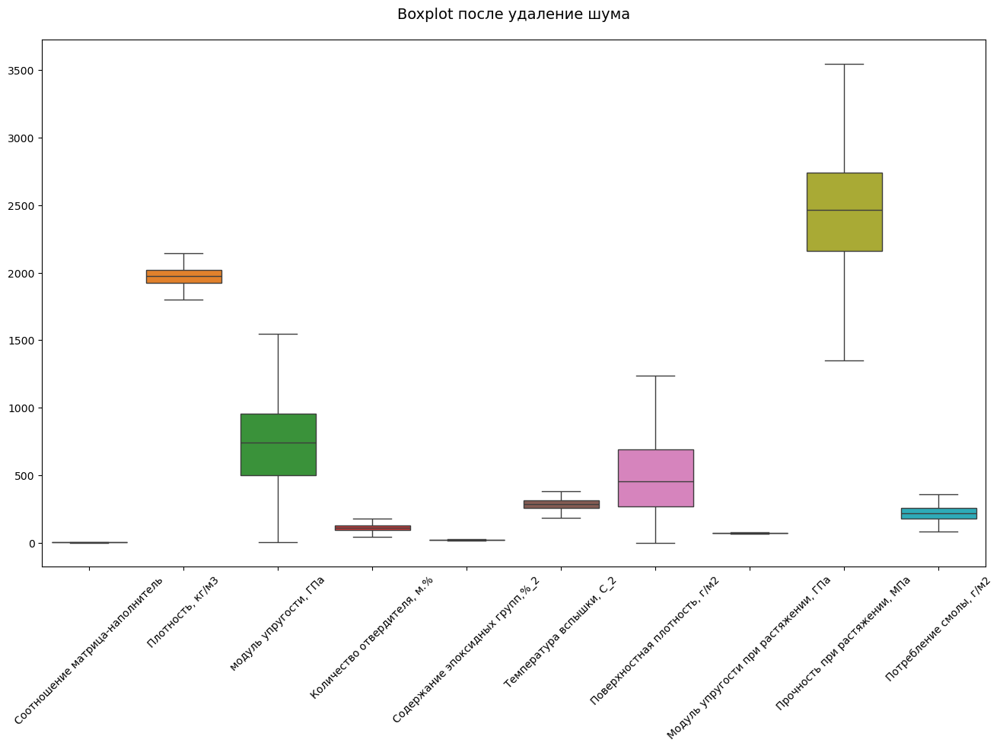

In [15]:
plt.figure(figsize=(16,9)) 
plt.title("Boxplot после удаление шума", fontsize=14, pad=20)
sns.boxplot(data=df_trimmed)
plt.xticks(rotation=45)  # Поворот подписей осей X для удобства
plt.show()

In [16]:
df.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
count,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000
mean,2.931709,1975.571219,739.832687,110.542434,22.243874,285.909992,483.011654,73.328467,2467.172673,218.388487
std,0.914142,73.821862,330.182856,28.290345,2.405795,40.942290,280.671597,3.118024,485.381882,59.789881
min,0.389403,1731.764635,2.436909,17.740275,14.254985,160.255843,0.603740,64.054061,1036.856605,33.803026
25%,2.319166,1924.198106,498.519344,92.228826,20.559280,258.574041,268.217818,71.303990,2144.891733,179.211987
50%,2.908787,1977.562320,741.037038,110.226287,22.230779,285.811108,453.919475,73.253725,2461.043398,217.344269
75%,3.552902,2021.145909,962.774186,130.265525,23.981928,313.566196,694.083948,75.373636,2759.752788,257.495622
max,5.591742,2207.773481,1911.536477,198.953207,28.955094,413.273418,1399.542362,82.682051,3848.436732,414.590628


In [17]:
df_trimmed.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
count,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000
mean,2.924276,1974.231795,734.124704,110.586720,22.244611,285.698889,479.576529,73.279339,2457.734779,218.924219
std,0.870832,68.950768,321.637592,26.180101,2.329930,39.105932,275.313799,2.941249,435.512998,56.549604
min,0.749223,1801.940695,2.436909,43.132583,16.391595,187.562353,0.603740,66.052747,1348.288251,82.583161
25%,2.337851,1925.610616,498.519344,92.922201,20.583309,259.141151,268.217818,71.335982,2160.577394,180.410124
50%,2.918289,1975.571219,739.832687,110.542434,22.243874,285.909992,453.919475,73.328467,2466.925422,218.388487
75%,3.540806,2019.601135,956.971948,129.442140,23.962165,312.790306,690.364836,75.280332,2740.229631,256.784428
max,5.120368,2145.260352,1546.290886,179.645962,28.324968,383.938404,1238.476416,80.419862,3548.054731,359.052220


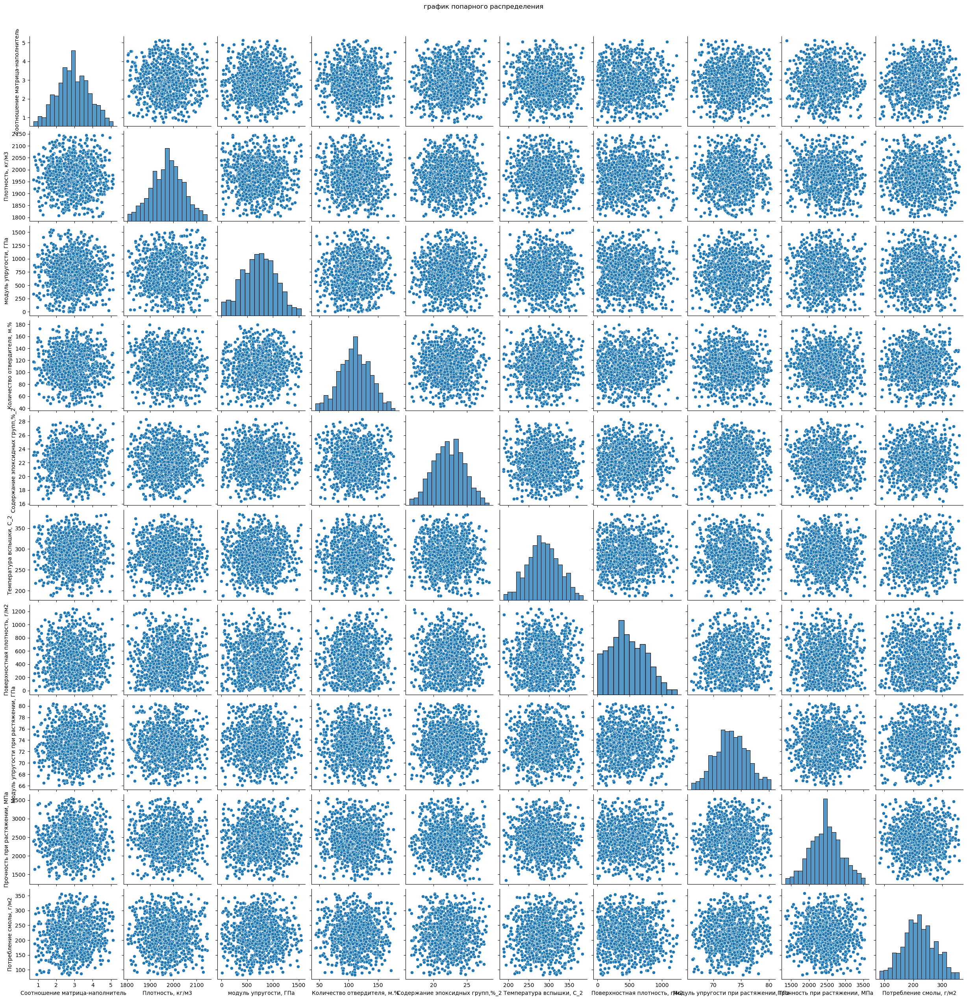

In [18]:
sns.pairplot(df_trimmed)
plt.suptitle("график попарного распределения", y=1.02)
plt.show()

In [19]:
from sklearn.preprocessing import RobustScaler
scaler = RobustScaler()
X_scaled = scaler.fit_transform(df_trimmed)
X_scaled_df = pd.DataFrame(X_scaled, columns=['Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'модуль упругости, ГПа','Количество отвердителя, м.%','Содержание эпоксидных групп,%_2','Температура вспышки, С_2','Поверхностная плотность, г/м2','Модуль упругости при растяжении, ГПа','Прочность при растяжении, МПа','Потребление смолы, г/м2',])
X_scaled_df.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
count,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000
mean,0.004977,-0.014251,-0.012451,0.001213,0.000218,-0.003935,0.060778,-0.012455,-0.015855,0.007015
std,0.723911,0.733593,0.701572,0.716871,0.689561,0.728920,0.652175,0.745687,0.751335,0.740427
min,-1.803115,-1.847320,-1.608445,-1.845837,-1.732029,-1.833163,-1.073834,-1.844593,-1.929842,-1.778155
25%,-0.482510,-0.531549,-0.526365,-0.482483,-0.491458,-0.498961,-0.439898,-0.505149,-0.528503,-0.497266
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.517490,0.468451,0.473635,0.517517,0.508542,0.501039,0.560102,0.494851,0.471497,0.502734
max,1.830559,1.805386,1.759087,1.892214,1.799749,1.827213,1.858492,1.797862,1.865134,1.841768


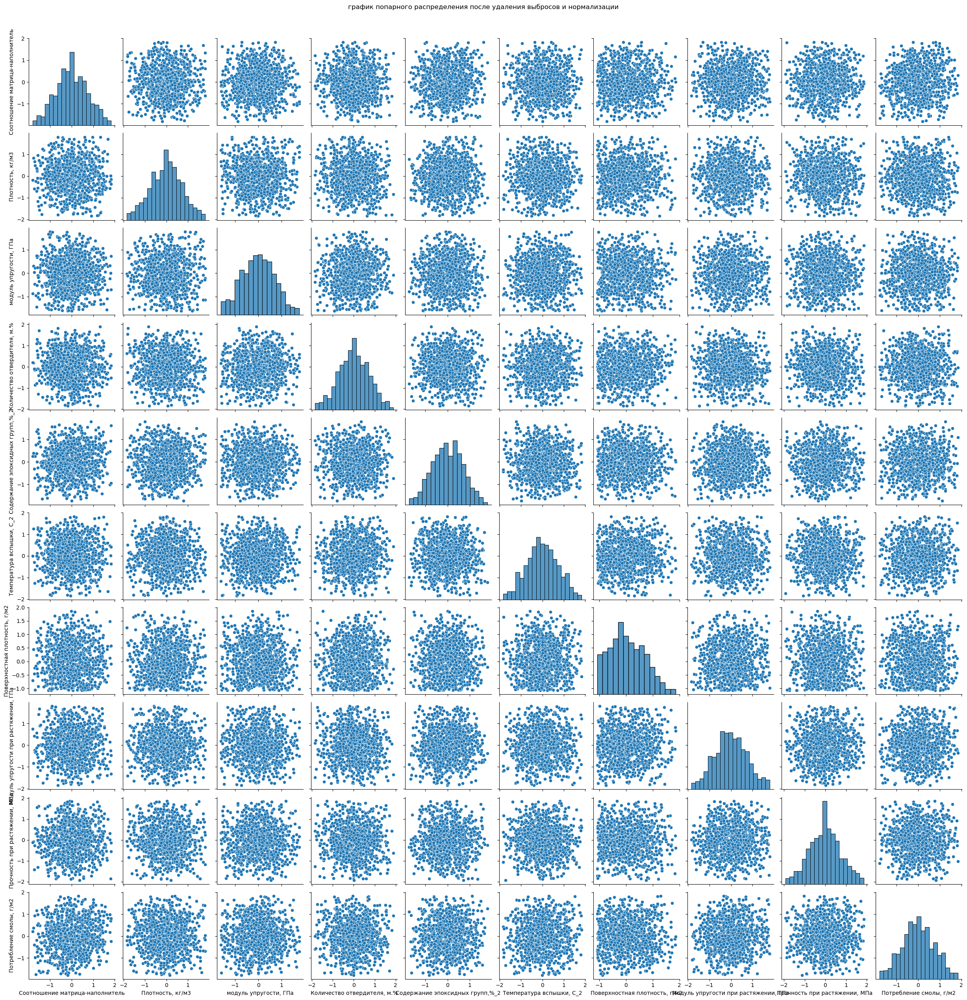

In [20]:
sns.pairplot(X_scaled_df)
plt.suptitle("график попарного распределения после удаления выбросов и нормализации", y=1.02)
plt.show()

In [21]:
#scaler = StandardScaler()
#X_scaled = scaler.fit_transform(df_x) 
df_s2 = pd.DataFrame(df_trimmed, columns=['Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'модуль упругости, ГПа','Количество отвердителя, м.%','Содержание эпоксидных групп,%_2','Температура вспышки, С_2','Поверхностная плотность, г/м2','Модуль упругости при растяжении, ГПа','Прочность при растяжении, МПа','Потребление смолы, г/м2',])
df_s2.head()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
22,4.029126,1880.000000,622.000000,111.860000,22.267857,284.615385,470.000000,73.333333,2455.555556,220.000000
23,2.587348,1953.274926,1136.596135,137.627420,22.344534,234.716883,555.893453,73.328467,2587.342983,246.613117
24,2.499918,1942.595777,901.519947,146.252208,23.081757,351.231874,864.725484,76.178075,2467.172673,226.222760
25,2.046471,2037.631811,707.570887,101.617251,23.146393,312.307205,547.601219,73.817067,2624.026407,178.198556
26,1.856476,2018.220332,836.294382,135.401697,26.435515,327.510377,150.961449,77.210762,2473.187195,123.344561


5169.250661222852


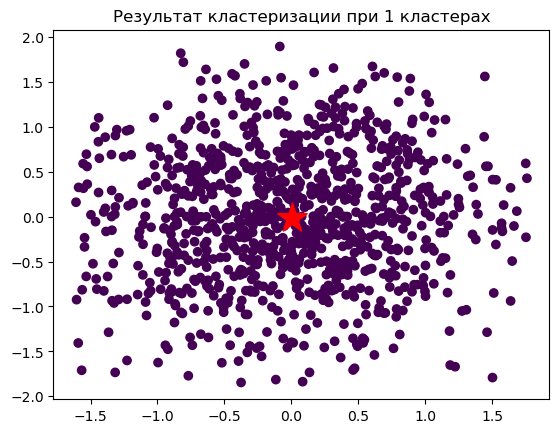

4748.853466497099


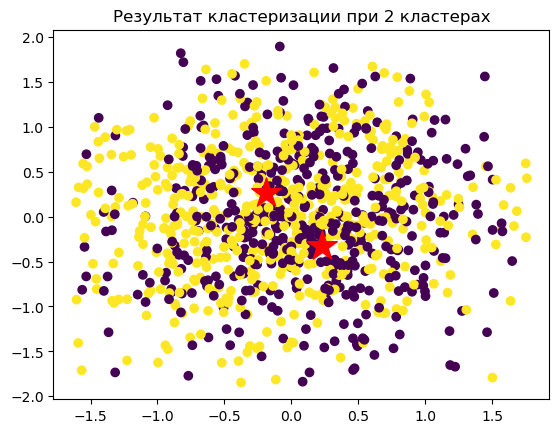

4465.631394008121


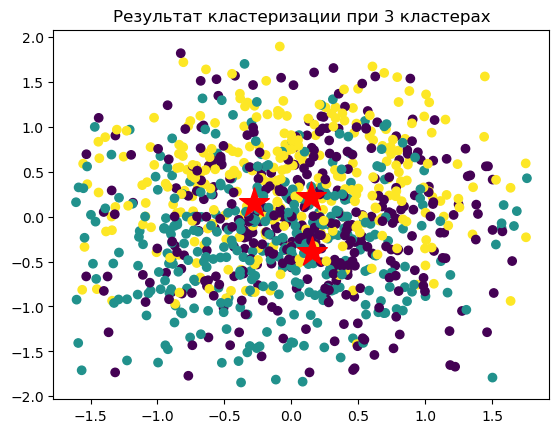

4255.938561880381


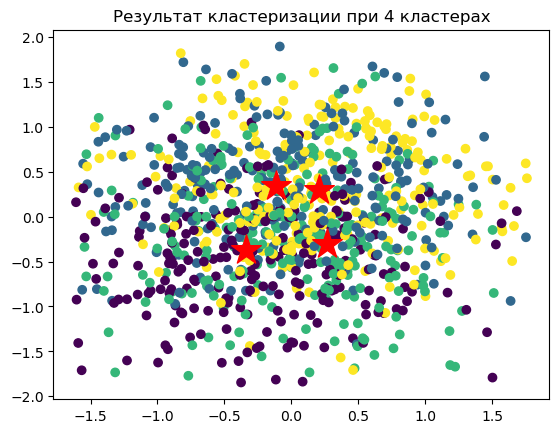

4084.137768525625


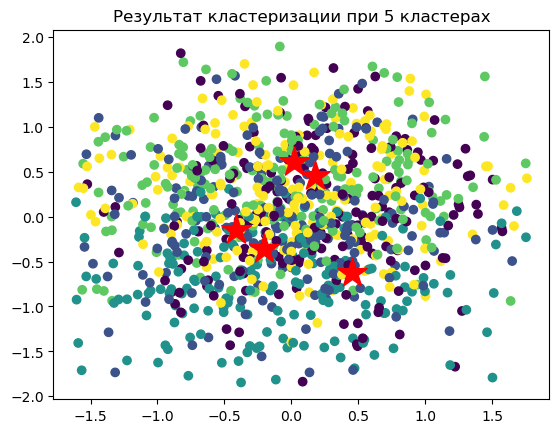

3939.72528530859


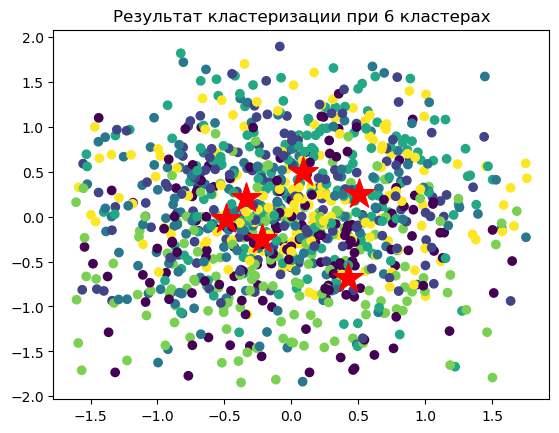

3818.8114380762095


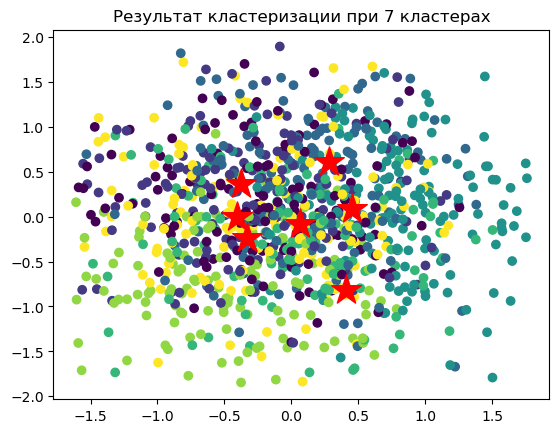

3726.0691129857605


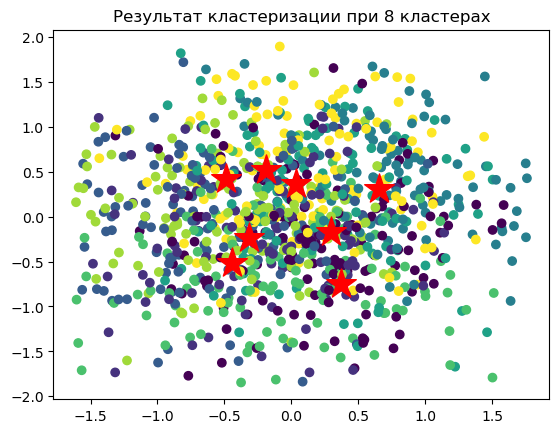

3634.7101261984053


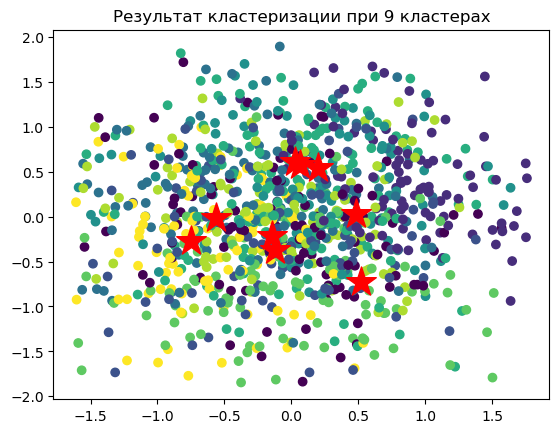

3542.2610227687182


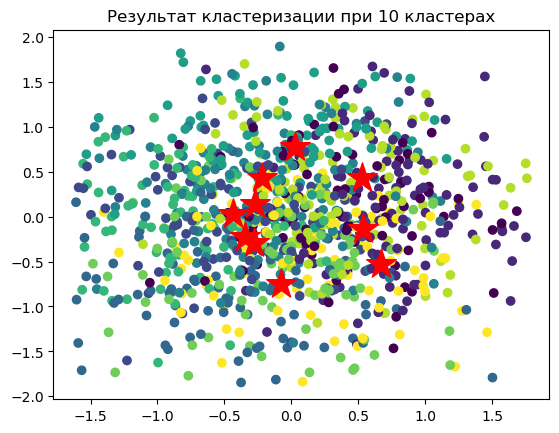

3488.598769471189


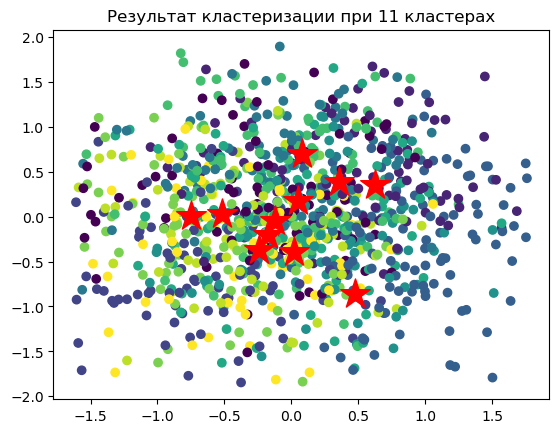

3420.178744027984


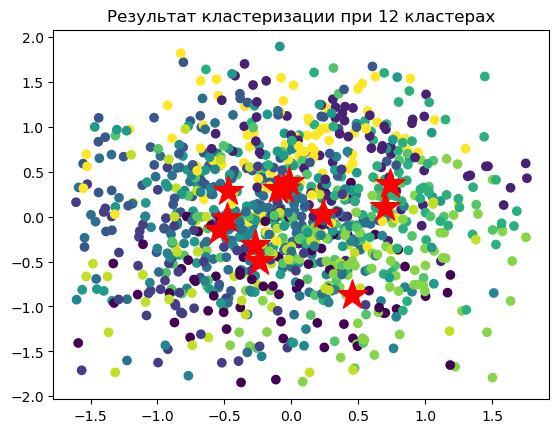

3356.487857236145


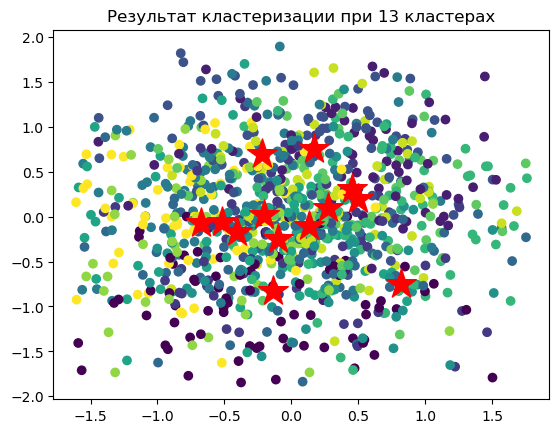

3314.7692579038694


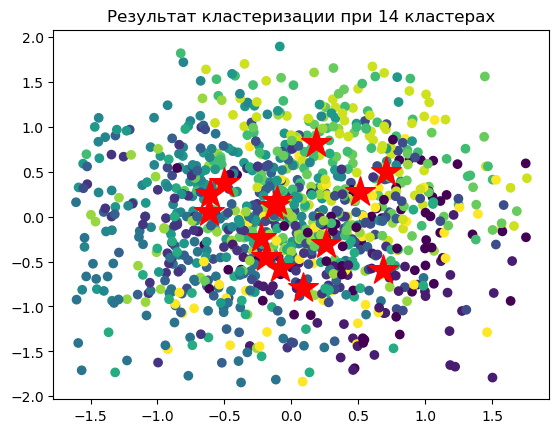

In [22]:
distortions = []
count_of_clusters = []
for i in range(1, 15):
    kmeans = KMeans(n_clusters=i,
    init='k-means++',
    n_init=20,   # или число, например 20
    max_iter=300,
    random_state=42
)

    kmeans_prediction = kmeans.fit_predict(X_scaled)

    
    distortions.append(kmeans.inertia_)
    print(kmeans.inertia_)
    count_of_clusters.append(i)

    plt.title(f"Результат кластеризации при {i} кластерах")
    plt.scatter(X_scaled[:, 2], X_scaled[:, 3], c = kmeans_prediction)
    plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1],
            marker="*", s=500, color='r')
    plt.show()

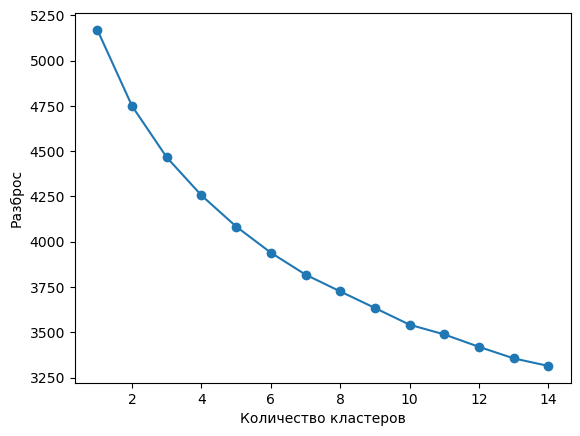

In [23]:
plt.plot(count_of_clusters, distortions, marker='o')
plt.xlabel('Количество кластеров')
plt.ylabel('Разброс')
plt.show()

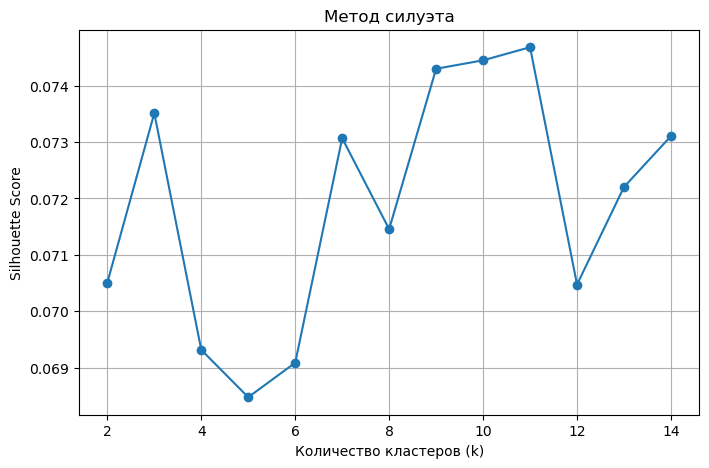

In [24]:
from sklearn.metrics import silhouette_score

silhouette_scores = []
for k in range(2, 15):
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42)
    labels = kmeans.fit_predict(X_scaled)
    score = silhouette_score(X_scaled, labels)
    silhouette_scores.append(score)

# Построение графика силуэта
plt.figure(figsize=(8, 5))
plt.plot(range(2, 15), silhouette_scores, marker='o')
plt.xlabel('Количество кластеров (k)')
plt.ylabel('Silhouette Score')
plt.title('Метод силуэта')
plt.grid()
plt.show()

In [25]:
kmeans = KMeans(
    n_clusters=6,
    init='k-means++',
    n_init=20,   # или число, например 20
    max_iter=300,
    random_state=42
)
kmeans.fit(X_scaled)
kmeans_prediction = kmeans.predict(X_scaled)
kmeans_prediction

array([3, 3, 0, ..., 3, 1, 3], dtype=int32)

In [26]:
data_viz = X_scaled.copy()
df_s = pd.DataFrame(data_viz, columns=['Соотношение матрица-наполнитель', 'Плотность, кг/м3', 'модуль упругости, ГПа','Количество отвердителя, м.%','Содержание эпоксидных групп,%_2','Температура вспышки, С_2','Поверхностная плотность, г/м2','Модуль упругости при растяжении, ГПа','Прочность при растяжении, МПа','Потребление смолы, г/м2',])
df_s['Cluster'] = kmeans_prediction
df_s

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Cluster
0,0.923424,-1.016818,-0.257023,0.036078,0.007098,-0.024131,0.038092,0.001234,-0.019615,0.021100,3
1,-0.275107,-0.237219,0.865440,0.741649,0.029791,-0.954220,0.241560,0.000000,0.207741,0.369557,3
2,-0.347786,-0.350838,0.352680,0.977816,0.247978,1.217575,0.973135,0.722453,0.000427,0.102577,0
3,-0.724730,0.660286,-0.070371,-0.244392,0.267108,0.492034,0.221917,0.123873,0.271026,-0.526223,5
4,-0.882671,0.453760,0.210407,0.680704,1.240550,0.775415,-0.717660,0.984267,0.010803,-1.244449,5
...,...,...,...,...,...,...,...,...,...,...,...
996,-0.537795,-0.249848,0.377406,-0.644860,-0.627616,0.724421,-0.579705,-0.060214,-0.137381,-1.222673,5
997,0.437035,0.792824,-0.643687,0.970416,-0.782544,-0.590775,-0.244604,-0.103348,-0.183787,-1.317961,5
998,0.301188,-0.034028,-0.704536,-0.000245,0.507162,-0.698743,0.678018,0.356428,0.338100,0.238539,3
999,0.654274,0.970614,0.003583,0.844895,-0.886965,-0.188822,0.444273,0.181080,-0.681805,-0.278398,1


In [27]:
df_trimmed['Cluster'] = kmeans_prediction
df_trimmed

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Cluster
22,4.029126,1880.000000,622.000000,111.860000,22.267857,284.615385,470.000000,73.333333,2455.555556,220.000000,3
23,2.587348,1953.274926,1136.596135,137.627420,22.344534,234.716883,555.893453,73.328467,2587.342983,246.613117,3
24,2.499918,1942.595777,901.519947,146.252208,23.081757,351.231874,864.725484,76.178075,2467.172673,226.222760,0
25,2.046471,2037.631811,707.570887,101.617251,23.146393,312.307205,547.601219,73.817067,2624.026407,178.198556,5
26,1.856476,2018.220332,836.294382,135.401697,26.435515,327.510377,150.961449,77.210762,2473.187195,123.344561,5
...,...,...,...,...,...,...,...,...,...,...,...
1018,2.271346,1952.087902,912.855545,86.992183,20.123249,324.774576,209.198700,73.090961,2387.292495,125.007669,5
1019,3.444022,2050.089171,444.732634,145.981978,19.599769,254.215401,350.660830,72.920827,2360.392784,117.730099,5
1020,3.280604,1972.372865,416.836524,110.533477,23.957502,248.423047,740.142791,74.734344,2662.906040,236.606764,3
1021,3.705351,2066.799773,741.475517,141.397963,19.246945,275.779840,641.468152,74.042708,2071.715856,197.126067,1


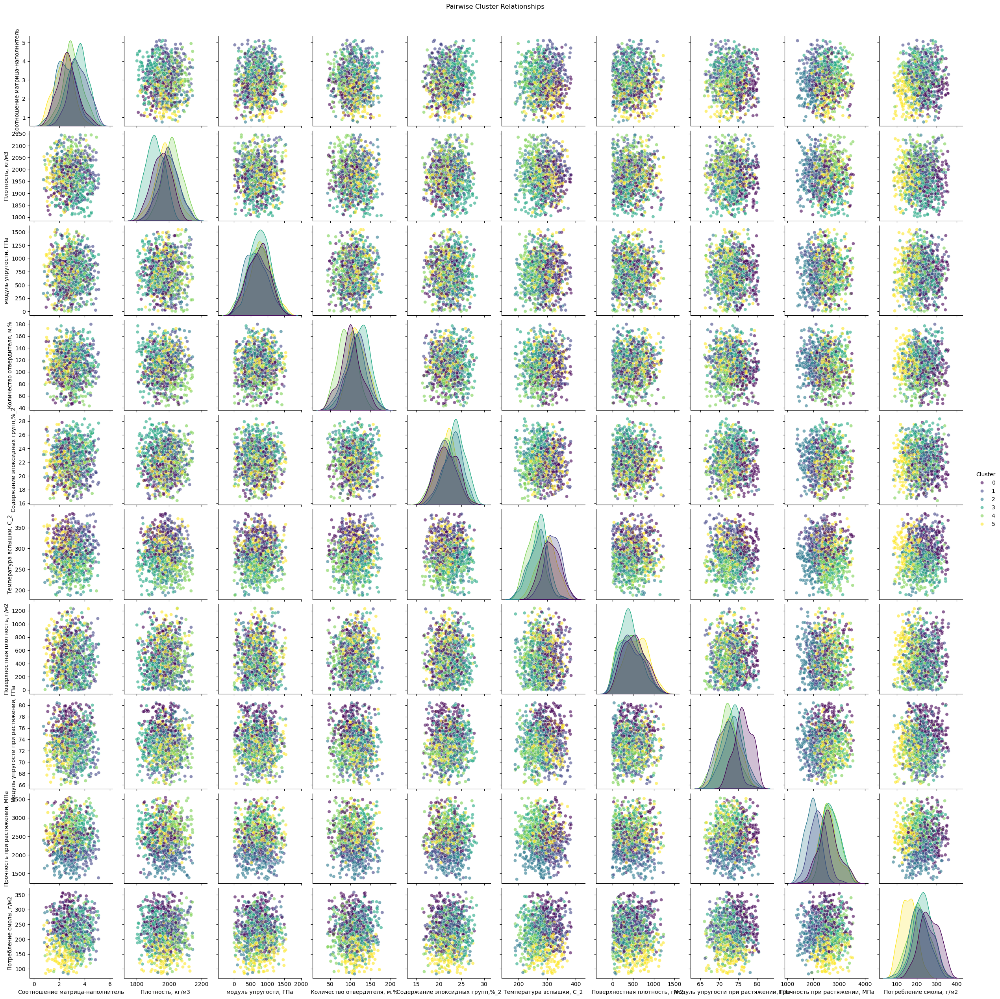

In [28]:
# Строим попарные графики
sns.pairplot(df_trimmed, hue='Cluster', palette='viridis', plot_kws={'alpha':0.6})
plt.suptitle("Pairwise Cluster Relationships", y=1.02)
plt.show()

In [29]:
df_s.head(5)


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Cluster
0,0.923424,-1.016818,-0.257023,0.036078,0.007098,-0.024131,0.038092,0.001234,-0.019615,0.021100,3
1,-0.275107,-0.237219,0.865440,0.741649,0.029791,-0.954220,0.241560,0.000000,0.207741,0.369557,3
2,-0.347786,-0.350838,0.352680,0.977816,0.247978,1.217575,0.973135,0.722453,0.000427,0.102577,0
3,-0.724730,0.660286,-0.070371,-0.244392,0.267108,0.492034,0.221917,0.123873,0.271026,-0.526223,5
4,-0.882671,0.453760,0.210407,0.680704,1.240550,0.775415,-0.717660,0.984267,0.010803,-1.244449,5


In [33]:
df_s['Cluster'].unique()

array([3, 0, 5, 1, 4, 2], dtype=int32)

Разобъем набор на обучающий и проверочный

In [41]:
df_y= df_trimmed.iloc[:,7:9]
df_x = df_trimmed.drop(['Модуль упругости при растяжении, ГПа','Прочность при растяжении, МПа'], axis = 1)
df_x

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Потребление смолы, г/м2",Cluster
22,4.029126,1880.000000,622.000000,111.860000,22.267857,284.615385,470.000000,220.000000,3
23,2.587348,1953.274926,1136.596135,137.627420,22.344534,234.716883,555.893453,246.613117,3
24,2.499918,1942.595777,901.519947,146.252208,23.081757,351.231874,864.725484,226.222760,0
25,2.046471,2037.631811,707.570887,101.617251,23.146393,312.307205,547.601219,178.198556,5
26,1.856476,2018.220332,836.294382,135.401697,26.435515,327.510377,150.961449,123.344561,5
...,...,...,...,...,...,...,...,...,...
1018,2.271346,1952.087902,912.855545,86.992183,20.123249,324.774576,209.198700,125.007669,5
1019,3.444022,2050.089171,444.732634,145.981978,19.599769,254.215401,350.660830,117.730099,5
1020,3.280604,1972.372865,416.836524,110.533477,23.957502,248.423047,740.142791,236.606764,3
1021,3.705351,2066.799773,741.475517,141.397963,19.246945,275.779840,641.468152,197.126067,1


In [42]:
X_train, X_test, Y_train, Y_test = train_test_split(df_x,df_y, test_size = 0.3, shuffle=True, random_state = 0)

In [43]:
y_test_elastic = Y_test.iloc[:,0]#.values  # numpy-массив
y_test_strength = Y_test.iloc[:,1]#.values       # numpy-массив
y_train_elastic = Y_train.iloc[:,0]#.values  # numpy-массив
y_train_strength = Y_train.iloc[:,1]#.values       # numpy-массив

In [44]:
X_train.iloc[:,8]

90     5
503    2
641    2
458    1
280    3
      ..
857    1
214    0
651    5
581    2
706    2
Name: Cluster, Length: 700, dtype: int32

In [45]:
X_train[['Cluster']]

,Cluster
90,5
503,2
641,2
458,1
280,3
...,...
857,1
214,0
651,5
581,2


In [46]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LinearRegression
import pandas as pd
import numpy as np

# 2. OneHot Encoding
train_index = X_train.index
test_index = X_test.index
#encoder = OneHotEncoder(sparse_output=False, drop='first')
encoder = OneHotEncoder(sparse_output=False,)
cluster_encoded_train = encoder.fit_transform(X_train[['Cluster']])
cluster_encoded_test = encoder.transform(X_test[['Cluster']])
feature_names = encoder.get_feature_names_out(['Cluster'])
cluster_train_df = pd.DataFrame(cluster_encoded_train, columns=feature_names,index=train_index)
cluster_test_df = pd.DataFrame(cluster_encoded_test, columns=feature_names,index=test_index)
X_train_encoded = pd.concat([
    X_train.drop('Cluster', axis=1),
    cluster_train_df
], axis=1)

X_test_encoded = pd.concat([
    X_test.drop('Cluster', axis=1),
    cluster_test_df
], axis=1)
# 6. Проверяем размерности
print("Форма X_train_encoded:", X_train_encoded.shape)
print("Форма cluster_encoded_train:", cluster_encoded_train.shape)
print("Названия столбцов:", feature_names)
cluster_train_df.head(5)

Форма X_train_encoded: (700, 14)
Форма cluster_encoded_train: (700, 6)
Названия столбцов: ['Cluster_0' 'Cluster_1' 'Cluster_2' 'Cluster_3' 'Cluster_4' 'Cluster_5']


,Cluster_0,Cluster_1,Cluster_2,Cluster_3,Cluster_4,Cluster_5
90,0.0,0.0,0.0,0.0,0.0,1.0
503,0.0,0.0,1.0,0.0,0.0,0.0
641,0.0,0.0,1.0,0.0,0.0,0.0
458,0.0,1.0,0.0,0.0,0.0,0.0
280,0.0,0.0,0.0,1.0,0.0,0.0


In [47]:
cluster_train_df.head(5)

,Cluster_0,Cluster_1,Cluster_2,Cluster_3,Cluster_4,Cluster_5
90,0.0,0.0,0.0,0.0,0.0,1.0
503,0.0,0.0,1.0,0.0,0.0,0.0
641,0.0,0.0,1.0,0.0,0.0,0.0
458,0.0,1.0,0.0,0.0,0.0,0.0
280,0.0,0.0,0.0,1.0,0.0,0.0


In [48]:
X_train.head(5)

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Потребление смолы, г/м2",Cluster
90,2.143617,1924.864832,957.378290,116.753626,21.978814,334.333067,679.950217,111.056523,5
503,1.367585,2088.013591,923.421474,110.542434,23.119301,251.997689,59.939393,218.388487,2
641,2.770720,1887.288244,1192.344813,122.378495,24.520994,306.206028,668.451348,180.644374,2
458,2.127935,1990.495542,667.836803,80.474542,24.998201,330.675199,402.772337,295.458299,1
280,3.678477,2005.412966,414.375364,131.173357,24.666328,260.705547,485.516113,283.367708,3


In [51]:
X_train_encoded.head(5)

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Потребление смолы, г/м2",Cluster_0,Cluster_1,Cluster_2,Cluster_3,Cluster_4,Cluster_5
90,2.143617,1924.864832,957.378290,116.753626,21.978814,334.333067,679.950217,111.056523,0.0,0.0,0.0,0.0,0.0,1.0
503,1.367585,2088.013591,923.421474,110.542434,23.119301,251.997689,59.939393,218.388487,0.0,0.0,1.0,0.0,0.0,0.0
641,2.770720,1887.288244,1192.344813,122.378495,24.520994,306.206028,668.451348,180.644374,0.0,0.0,1.0,0.0,0.0,0.0
458,2.127935,1990.495542,667.836803,80.474542,24.998201,330.675199,402.772337,295.458299,0.0,1.0,0.0,0.0,0.0,0.0
280,3.678477,2005.412966,414.375364,131.173357,24.666328,260.705547,485.516113,283.367708,0.0,0.0,0.0,1.0,0.0,0.0


In [76]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, r2_score

# Инициализация и обучение модели
model = LinearRegression()
model.fit(X_train_encoded, y_train_elastic)

# Предсказание на тестовой выборке
y_pred = model.predict(X_test_encoded)

print(f"MAE: {mean_absolute_error(y_test_elastic, y_pred):.2f}")
print(f"R2: {r2_score(y_test_elastic, y_pred):.2f}")

MAE: 2.00
R2: 0.33


In [78]:
from sklearn.metrics import mean_absolute_error, r2_score

y_pred_train = model.predict(X_train_encoded)
print("Train MAE:", mean_absolute_error(y_train_elastic, y_pred_train))
print("Train R2:",  r2_score(y_train_elastic, y_pred_train))

y_pred_test = model.predict(X_test_encoded)
print("Test  MAE:", mean_absolute_error(y_test_elastic, y_pred_test))
print("Test  R2:",  r2_score(y_test_elastic, y_pred_test))


Train MAE: 1.9639591441834698
Train R2: 0.28090618849399207
Test  MAE: 2.0028806367297367
Test  R2: 0.3297766778925473


подбор гипер параметров для рф

In [41]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.metrics import mean_absolute_error, r2_score

param_grid_rf = {
    'n_estimators': [400, 500, 600],
    'max_depth': [ 3, 5, 7],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2],
    'max_features': ['sqrt', 0.8],
    'bootstrap': [True],
}

grid_rf = GridSearchCV(
    estimator=RandomForestRegressor(random_state=42, n_jobs=-1),
    param_grid=param_grid_rf,
    scoring='neg_mean_absolute_error',
    cv=KFold(n_splits=10, shuffle=True, random_state=42),
    verbose=1,
    n_jobs=-1
)

grid_rf.fit(X_train_encoded, y_train_elastic)
y_pred_rf = grid_rf.predict(X_test_encoded)

print("\n===== RandomForest =====")
print("Лучшие параметры:", grid_rf.best_params_)
print(f"CV MAE (лучшее): {-grid_rf.best_score_:.4f}")
print(f"Тест MAE: {mean_absolute_error(y_test_elastic, y_pred_rf):.4f}")
print(f"Тест R2:  {r2_score(y_test_elastic, y_pred_rf):.4f}")


Fitting 10 folds for each of 72 candidates, totalling 720 fits

===== RandomForest =====
Лучшие параметры: {'bootstrap': True, 'max_depth': 7, 'max_features': 0.8, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 400}
CV MAE (лучшее): 2.0175
Тест MAE: 2.0296
Тест R2:  0.2899


In [42]:
best_model_rf = grid_rf.best_estimator_
best_model_rf.fit(X_train_encoded, y_train_elastic)
y_pred_rf_final = best_model_rf.predict(X_test_encoded)
print(f"MAE: {mean_absolute_error(y_test_elastic, y_pred_rf_final):.2f}")
print(f"R2: {r2_score(y_test_elastic, y_pred_rf_final):.2f}")

MAE: 2.03
R2: 0.29


In [43]:
from sklearn.metrics import mean_absolute_error, r2_score

y_pred_train = best_model_rf.predict(X_train_encoded)
print("Train MAE:", mean_absolute_error(y_train_elastic, y_pred_train))
print("Train R2:",  r2_score(y_train_elastic, y_pred_train))

y_pred_test = best_model_rf.predict(X_test_encoded)
print("Test  MAE:", mean_absolute_error(y_test_elastic, y_pred_test))
print("Test  R2:",  r2_score(y_test_elastic, y_pred_test))


Train MAE: 1.4989940356929452
Train R2: 0.572332206839012
Test  MAE: 2.02960695581333
Test  R2: 0.28988407322351173


In [44]:
подбор гипер параметров для град

SyntaxError: invalid syntax (239698097.py, line 1)

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
param_grid_gb = {
    'n_estimators': [400, 500, ],
    'max_depth': [3, 4, ],
    "learning_rate" : [0.03, 0.01],
    
}

grid_rf = GridSearchCV(
    estimator=GradientBoostingRegressor(random_state=42),
    param_grid=param_grid_gb,
    scoring='neg_mean_absolute_error',
    cv=KFold(n_splits=10, shuffle=True, random_state=42),
    verbose=1,
    n_jobs=-1
)

grid_rf.fit(X_train_encoded, y_train_elastic)
y_pred_rf = grid_rf.predict(X_test_encoded)

print("\n===== RandomForest =====")
print("Лучшие параметры:", grid_rf.best_params_)
print(f"CV MAE (лучшее): {-grid_rf.best_score_:.4f}")
print(f"Тест MAE: {mean_absolute_error(y_test_elastic, y_pred_rf):.4f}")
print(f"Тест R2:  {r2_score(y_test_elastic, y_pred_rf):.4f}")

In [80]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
model_gbr = GradientBoostingRegressor(
    n_estimators=400,       # количество деревьев
    learning_rate=0.01,     # скорость обучения
    max_depth=4,            # глубина деревьев
    random_state=42
)

model_gbr.fit(X_train_encoded, y_train_elastic)
y_pred_gbr = model_gbr.predict(X_test_encoded)
print(f"MAE: {mean_absolute_error(y_test_elastic, y_pred):.2f}")
print(f"R2: {r2_score(y_test_elastic, y_pred):.2f}")


MAE: 2.00
R2: 0.33


In [88]:
joblib.dump(model_gbr, 'elastic_modell.pkl')

['elastic_modell.pkl']

In [45]:
from sklearn.metrics import mean_absolute_error, r2_score

y_pred_train = model_gbr.predict(X_train_encoded)
print("Train MAE:", mean_absolute_error(y_train_elastic, y_pred_train))
print("Train R2:",  r2_score(y_train_elastic, y_pred_train))

y_pred_test = model_gbr.predict(X_test_encoded)
print("Test  MAE:", mean_absolute_error(y_test_elastic, y_pred_test))
print("Test  R2:",  r2_score(y_test_elastic, y_pred_test))


NameError: name 'model_gbr' is not defined

Нарисуем график сравнения двух регрессоров 

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(y_test_elastic.values, label='Настоящие значения', color='black', linewidth=2)

# Предсказания моделей
plt.plot(y_pred, label='LinearRegression', linestyle='--', color='blue')
plt.plot(y_pred_rf_final, label='RandomForest', linestyle='-.', color='green')
plt.plot(y_pred_gbr, label='GB', linestyle='-.', color='red')

plt.title('Сравнение предсказаний разных моделей')
plt.xlabel('Наблюдение')
plt.ylabel('Упругость (ГПа)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
plt.figure(figsize=(10, 5))

plt.scatter(y_test_elastic, y_pred, label="LinearRegression", alpha=0.6, color='blue')
plt.scatter(y_test_elastic, y_pred_rf_final, label="RandomForest", alpha=0.6, color='green')
plt.scatter(y_test_elastic, y_pred_gbr, label='GB', alpha=0.6, color='red')

plt.plot([y_test_elastic.min(), y_test_elastic.max()],
         [y_test_elastic.min(), y_test_elastic.max()],
         color='gray', linewidth=2, label='Идеальное совпадение')

plt.xlabel("Настоящее значение")
plt.ylabel("Предсказание")
plt.title("Scatter plot: сравнение точности моделей")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


Обучим модель для плотности

In [ ]:
y_train_elastic

In [ ]:
y_train_strength

In [81]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, r2_score

# Инициализация и обучение модели
model2 = LinearRegression()
model2.fit(X_train_encoded, y_train_strength)

# Предсказание на тестовой выборке
y_pred2 = model2.predict(X_test_encoded)

print(f"MAE: {mean_absolute_error(y_test_strength, y_pred2):.2f}")
print(f"R2: {r2_score(y_test_strength, y_pred2):.2f}")

MAE: 275.59
R2: 0.40


In [63]:
from sklearn.metrics import mean_absolute_error, r2_score

y_pred_train = model2.predict(X_train_encoded)
print("Train MAE:", mean_absolute_error(y_train_strength, y_pred_train))
print("Train R2:",  r2_score(y_train_strength, y_pred_train))

y_pred_test = model2.predict(X_test_encoded)
print("Test  MAE:", mean_absolute_error(y_test_strength, y_pred_test))
print("Test  R2:",  r2_score(y_test_strength, y_pred_test))


Train MAE: 260.5265595228535
Train R2: 0.4128735614454888
Test  MAE: 275.5917305139358
Test  R2: 0.4047319085150265


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.metrics import mean_absolute_error, r2_score

param_grid_rf2 = {
    'n_estimators': [ 400, 500, 600],
    'max_depth': [ 3, 5],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2],
    'max_features': ['sqrt', 0.8],
    'bootstrap': [True],
}

grid_rf2 = GridSearchCV(
    estimator=RandomForestRegressor(random_state=42, n_jobs=-1),
    param_grid=param_grid_rf,
    scoring='neg_mean_absolute_error',
    cv=KFold(n_splits=10, shuffle=True, random_state=42),
    verbose=1,
    n_jobs=-1
)

grid_rf2.fit(X_train_encoded, y_train_strength)
y_pred_rf2 = grid_rf2.predict(X_test_encoded)

print("\n===== RandomForest =====")
print("Лучшие параметры:", grid_rf2.best_params_)
print(f"CV MAE (лучшее): {-grid_rf2.best_score_:.4f}")
print(f"Тест MAE: {mean_absolute_error(y_test_strength, y_pred_rf2):.4f}")
print(f"Тест R2:  {r2_score(y_test_strength, y_pred_rf2):.4f}")


In [96]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
modelrf = RandomForestRegressor(
    n_estimators=400,       # количество деревьев     # скорость обучения
    max_depth=3,
    min_samples_leaf=2,
    min_samples_split=2,
    max_features=0.8,# глубина деревьев
    random_state=42,
    bootstrap=True
)

modelrf.fit(X_train_encoded, y_train_strength)
y_predrf2 = modelrf.predict(X_test_encoded)
print(f"MAE: {mean_absolute_error(y_test_strength, y_predrf2):.2f}")
print(f"R2: {r2_score(y_test_strength, y_predrf2):.2f}")


MAE: 278.81
R2: 0.40


In [94]:
joblib.dump(modelrf, 'strainght_modell.pkl')

['strainght_modell.pkl']

In [67]:
from sklearn.metrics import mean_absolute_error, r2_score

y_pred_train = modelrf.predict(X_train_encoded)
print("Train MAE:", mean_absolute_error(y_train_strength, y_pred_train))
print("Train R2:",  r2_score(y_train_strength, y_pred_train))

y_pred_test = modelrf.predict(X_test_encoded)
print("Test  MAE:", mean_absolute_error(y_test_strength, y_pred_test))
print("Test  R2:",  r2_score(y_test_strength, y_pred_test))


Train MAE: 251.76710226804244
Train R2: 0.44877096001357974
Test  MAE: 278.812817828372
Test  R2: 0.4011171974669909


In [ ]:
best_model_rf2 = grid_rf2.best_estimator_
best_model_rf2.fit(X_train_encoded, y_train_strength)
y_pred_rf_final2 = best_model_rf2.predict(X_test_encoded)
print(f"MAE: {mean_absolute_error(y_test_strength, y_pred_rf_final2):.2f}")
print(f"R2: {r2_score(y_test_elastic, y_pred_rf_final2):.2f}")

In [ ]:
подбор гипер параметров для град

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
param_grid_gb = {
    'n_estimators': [400, 500, 600, ],
    'max_depth': [3, 4, ],
    "learning_rate" : [0.01],
    
}

grid_gb = GridSearchCV(
    estimator=GradientBoostingRegressor(random_state=42),
    param_grid=param_grid_gb,
    scoring='neg_mean_absolute_error',
    cv=KFold(n_splits=10, shuffle=True, random_state=42),
    verbose=1,
    n_jobs=-1
)

grid_gb.fit(X_train_encoded, y_train_strength)
y_pred_gb = grid_gb.predict(X_test_encoded)

print("\n===== RandomForest =====")
print("Лучшие параметры:", grid_gb.best_params_)
print(f"CV MAE (лучшее): {-grid_gb.best_score_:.4f}")
print(f"Тест MAE: {mean_absolute_error(y_test_strength, y_pred_gb):.4f}")
print(f"Тест R2:  {r2_score(y_test_strength, y_pred_gb):.4f}")

In [55]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
model_gbr2 = GradientBoostingRegressor(
    n_estimators=400,       # количество деревьев
    learning_rate=0.01,     # скорость обучения
    max_depth=3,            # глубина деревьев
    random_state=42
)

model_gbr2.fit(X_train_encoded, y_train_strength)
y_pred_gbr2 = model_gbr2.predict(X_test_encoded)
print(f"MAE: {mean_absolute_error(y_test_strength, y_pred_gbr2):.2f}")
print(f"R2: {r2_score(y_test_strength, y_pred_gbr2):.2f}")


MAE: 285.96
R2: 0.37


In [69]:
from sklearn.metrics import mean_absolute_error, r2_score

y_pred_train = model_gbr2.predict(X_train_encoded)
print("Train MAE:", mean_absolute_error(y_train_strength, y_pred_train))
print("Train R2:",  r2_score(y_train_strength, y_pred_train))

y_pred_test = model_gbr2.predict(X_test_encoded)
print("Test  MAE:", mean_absolute_error(y_test_strength, y_pred_test))
print("Test  R2:",  r2_score(y_test_strength, y_pred_test))


Train MAE: 230.91429808060585
Train R2: 0.5280699152574955
Test  MAE: 285.9595425220178
Test  R2: 0.36744814359730826


Нарисуем график сравнения двух регрессоров 

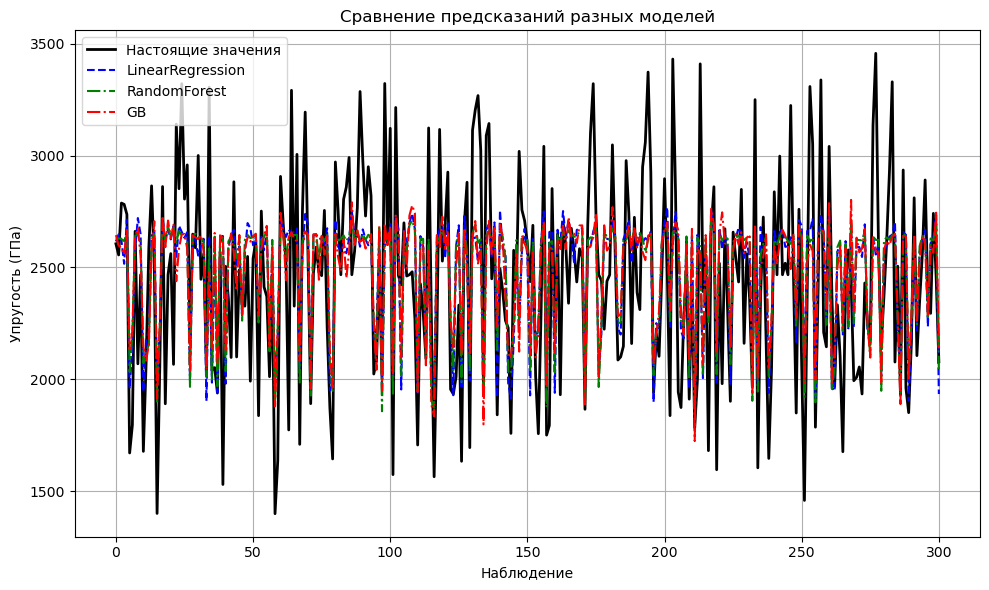

In [71]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(y_test_strength.values, label='Настоящие значения', color='black', linewidth=2)

# Предсказания моделей
plt.plot(y_pred2, label='LinearRegression', linestyle='--', color='blue')
plt.plot(y_predrf2, label='RandomForest', linestyle='-.', color='green')
plt.plot(y_pred_gbr2, label='GB', linestyle='-.', color='red')

plt.title('Сравнение предсказаний разных моделей')
plt.xlabel('Наблюдение')
plt.ylabel('Упругость (ГПа)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


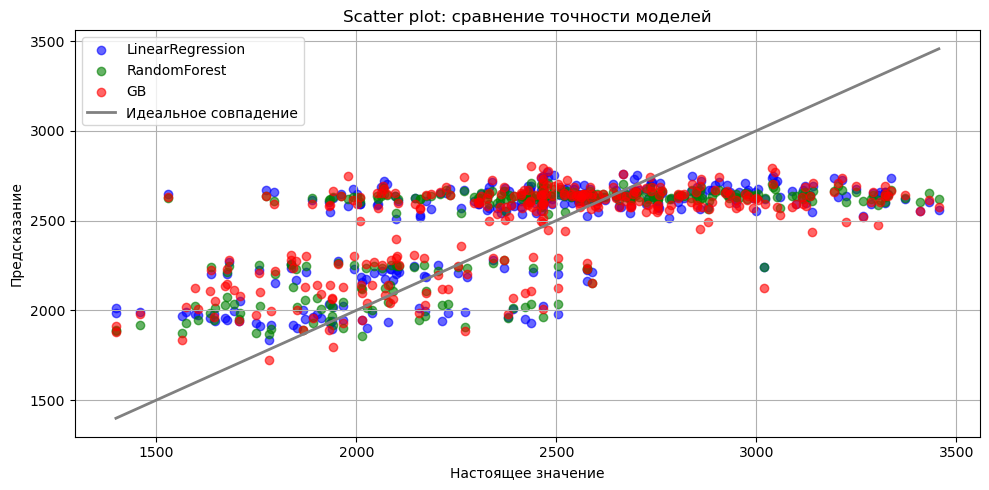

In [77]:
plt.figure(figsize=(10, 5))

plt.scatter(y_test_strength, y_pred2, label="LinearRegression", alpha=0.6, color='blue')
plt.scatter(y_test_strength, y_predrf2, label="RandomForest", alpha=0.6, color='green')
plt.scatter(y_test_strength, y_pred_gbr2, label='GB', alpha=0.6, color='red')

plt.plot([y_test_strength.min(), y_test_strength.max()],
         [y_test_strength.min(), y_test_strength.max()],
         color='gray', linewidth=2, label='Идеальное совпадение')

plt.xlabel("Настоящее значение")
plt.ylabel("Предсказание")
plt.title("Scatter plot: сравнение точности моделей")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
from sklearn.dummy import DummyRegressor
from sklearn.metrics import mean_absolute_error, r2_score

dummy = DummyRegressor(strategy='mean')
dummy.fit(X_train, y_train_strength)
y_pred_dummy = dummy.predict(X_test)
print("Dummy MAE:", mean_absolute_error(y_test_strength, y_pred_dummy))
print("Dummy R2:",  r2_score(y_test_strength, y_pred_dummy))


Метрички на трейне vs тесте (поймём пере/недообучение)

In [ ]:
from sklearn.metrics import mean_absolute_error, r2_score

y_pred_train = model.predict(X_train)
print("Train MAE:", mean_absolute_error(y_train_strength, y_pred_train))
print("Train R2:",  r2_score(y_train_strength, y_pred_train))

y_pred_test = model.predict(X_test)
print("Test  MAE:", mean_absolute_error(y_test_strength, y_pred_test))
print("Test  R2:",  r2_score(y_test_strength, y_pred_test))


In [ ]:
y_train_elastic.describe()

In [ ]:
import xgboost as xgb
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split


# Создание и обучение модели
model_xgb = xgb.XGBRegressor(
    n_estimators=100,  # Количество деревьев
    learning_rate=0.005,  # Скорость обучения
    max_depth=2,  # Глубина деревьев
    random_state=42
)
model_xgb.fit(X_train, y_train_elastic)

# Предсказание и оценка
Y_pred = model_xgb.predict(X_test)
print(f"MAE: {mean_absolute_error(y_test_elastic, Y_pred):.2f}")
print(f"R2: {r2_score(y_test_elastic, Y_pred):.2f}")

In [ ]:
import xgboost as xgb
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split


# Создание и обучение модели
model_xgb = xgb.XGBRegressor(
    n_estimators=100,  # Количество деревьев
    learning_rate=0.01,  # Скорость обучения
    max_depth=3,  # Глубина деревьев
    random_state=42
)
model_xgb.fit(X_train_encoded, y_train_elastic)

# Предсказание и оценка
Y_pred = model_xgb.predict(X_test_encoded)
print(f"MAE: {mean_absolute_error(y_test_elastic, Y_pred):.2f}")
print(f"R2: {r2_score(y_test_elastic, Y_pred):.2f}")

In [ ]:
для обучения модели где каждый кластер обучается отдельно 

In [ ]:
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error, r2_score

models = {}  # Словарь для хранения моделей

for cluster_id in df_s['Cluster'].unique():
    # Выбираем данные кластера
    cluster_data = df_s[df_s['Cluster'] == cluster_id]
    X_cluster = df_s
    y_cluster = df_y
    
    # Делим на train/test
    X_train, X_test, y_train, y_test = train_test_split(X_cluster, y_cluster, test_size=0.2)
    y_test_elastic = y_test.iloc[:,0]#.values  # numpy-массив
    y_test_strength = y_test.iloc[:,1]#.values       # numpy-массив
    y_train_elastic = y_train.iloc[:,0]#.values  # numpy-массив
    y_train_strength = y_train.iloc[:,1]#.values   
    
    # Обучаем модель
    model = XGBRegressor(n_estimators=100, max_depth=3, learning_rate=0.1)
    model.fit(X_train, y_train_elastic)
    
    # Оценка
    y_pred = model.predict(X_test)
    print(f"Cluster {cluster_id}:")
    print(f"  MAE: {mean_absolute_error(y_test_elastic, y_pred):.2f}")
    print(f"  R²: {r2_score(y_test_elastic, y_pred):.2f}")
    
    models[cluster_id] = model  # Сохраняем модель

In [ ]:
for cluster_id, model in models.items():
    print(f"\nCluster {cluster_id} - Важные признаки:")
    feat_importances = pd.Series(model.feature_importances_, index=X_cluster.columns)
    print(feat_importances.sort_values(ascending=False).head(5))